## Choosing the runtime

As with the Week 10 lab, in order for the code we need to install properly, you need to revert to an earlier runtime to access Python 3.11.

To do this, click on 'Runtime', then 'Change runtime type'. In the popup window, under 'Runtime version', select '2025.07' from the drop menu.

## Setting up the simulation environment

### Install condacolab

We first need to install condacolab, a Python package manager for Google colab.

Once you run condacolab.install(), the Python kernel will be restarted. This is normal and expected, and is required for the changes due to installing condalab to be applied. If you are wondering why you are seeing a message saying "Your session crashed for an unknown reason", this is why. You can safely ignore this message!

Once the kernal has restarted (when the cell below has finished executing), you can continue running the cells below like normal.

**Warning:** do not use the 'Run all option' under the Runtime menu at the top of the page. Run the condacolab cell below individually and wait for the kernel to restart. Only then can you run all cells (only if you want to).

In [1]:
!pip install -q condacolab
import condacolab
condacolab.install()

⏬ Downloading https://github.com/jaimergp/miniforge/releases/download/24.11.2-1_colab/Miniforge3-colab-24.11.2-1_colab-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:08
🔁 Restarting kernel...


Now check that everything is OK:

In [1]:
import condacolab
condacolab.check()

✨🍰✨ Everything looks OK!


### Mount Google Drive

Like in last week's exercise, data will be read from and written to your UoA Google Drive. To mount it, run the code in the cell below. You will be asked to click on a URL and log in to your Google Drive account. Copy the code produced, paste it into the box provided here, and hit 'Enter'.

In [2]:
# mount your Google Drive
from google.colab import drive
from google.colab import files
drive.flush_and_unmount()
drive.mount('/content/drive', force_remount=True)

Drive not mounted, so nothing to flush and unmount.
Mounted at /content/drive


### Viewing your Google Drive files

There are two ways to check and open/close/delete the files produced by this Colab worksheet.

One is to open Google Drive in another browser tab or window. You can browse the files produced here.

The other is to click on the folder icon at the left-hand side of this page. Click on 'drive' and then on 'MyDrive'. This should show a list of the files and folders in your current working directory (within your Google Drive). You can navigate through these just like you would on a computer file browser.

If you've clicked on the folder icon at the left-hand side of this page and it says 'Connect to a runtime to enable browsing', you need to click on the downarrow beside the RAM and Disk usage icons at the top right of the page and select 'Connect to a hosted runtime'. You should now be able to access your Google Drive files at the left-hand side of this page.

### Set up your working directory

Before you run the code below, you need to change what is inside the single quotation marks to match the location where this Colab worksheet is saved, and where you want to keep the input and output files for this exercise. The default, as specified below, is the highest level of your Google Drive ('My Drive'). Like for the previous weeks' exercises, I would strongly recommend that you make a folder for BIOSCI702 and then for each week's exercise (e.g. for this week, you would be working in 'BIOSCI702/Week 11').

If you are working in My Drive, you don't need to change anything before running the code below.

If you will be working in a specific folder for this exercise, you need to first make this in your Google Drive (if you haven't already). You can do this in a separate browser tab or window, or you can do it in the file list at the left-hand side of this page. Hover over 'My Drive', click on the three dots that appear at the right-hand side, and choose 'New Folder'. A new folder icon will appear with 'Untitled folder' in a text box beside it. Click on this text and type what you want to call this folder. Do this as many times as you need to create as many folders and subfolders as you want.

If this Colab worksheet isn't already in the folder where you want to work today, click on 'File' at the top left of this page, choose 'Move', and select the folder for this week's exercise.

Finally, in the file list at the left-hand side of this page, hover over the name of the subfolder created for this exercise, click on the three vertical dots, and choose 'Copy Path'. Paste this from the clipboard into the code below to replace '/content/drive/MyDrive' and (this is important!) add a final '/'. Now you can run the code below!

In [3]:
workingDir = '/content/drive/MyDrive/B760/'

### Install MDTraj and py3Dmol

Now we're ready to install some useful Python packages that don't come in the default Python distribution ([MDtraj](https://www.mdtraj.org/1.9.5/index.html) and [py3Dmol](https://3dmol.csb.pitt.edu/)) that you will need to analyse the simulations.

This will take a while...

In [4]:
!mamba install -q MDtraj 2>&1 1>/dev/null
!mamba install -q py3Dmol 2>&1 1>/dev/null

### Import python modules

The last 'setup' step is to import the Python modules that you just installed.

In [19]:
from sys import stdout
import time as time
import py3Dmol
import mdtraj as md
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

%matplotlib inline

## Define filenames

Here we define the filenames for the initial structure of each simulation and the simulation trajectory itself, in PDB format. Make sure you have uploaded them to your working directory in Google Drive as the next three blocks of code will try to read the files defined below.

In [6]:
# DCys file names
DCysInitPDBfilename = workingDir + 'DCys_prod_500ns_pbcmol_urcompact_center_proteinOnly_firstFrame.pdb'
DCysSimPDBfilename = workingDir + 'DCys_prod_500ns_pbcmol_urcompact_center_proteinOnly_fit_e10.pdb'
# load the DCys simulation 'trajectory'
DCysTraj = md.load(DCysSimPDBfilename, top=DCysInitPDBfilename)

# LCys file names
LCysInitPDBfilename = workingDir + 'LCys_prod_500ns_pbcmol_urcompact_center_proteinOnly_firstFrame.pdb'
LCysSimPDBfilename = workingDir + 'LCys_prod_500ns_pbcmol_urcompact_center_proteinOnly_fit_e10.pdb'
# load the DCys simulation 'trajectory'
LCysTraj = md.load(LCysSimPDBfilename, top=LCysInitPDBfilename)

In [7]:
# @title Set up simulation viewing
# Set up classes for processing PDB files
# [ Note: py3Dmol can read a single PDB file but this gives us more power ]
class Atom(dict):
    def __init__(self, line):
        self["type"] = line[0:6].strip()
        self["idx"] = line[6:11].strip()
        self["name"] = line[12:16].strip()
        self["resname"] = line[17:20].strip()
        self["resid"] = int(int(line[22:26]))
        self["x"] = float(line[30:38])
        self["y"] = float(line[38:46])
        self["z"] = float(line[46:54])
        self["sym"] = line[76:78].strip()

    def __str__(self):
        line = list(" " * 80)

        line[0:6] = self["type"].ljust(6)
        line[6:11] = self["idx"].ljust(5)
        line[12:16] = self["name"].ljust(4)
        line[17:20] = self["resname"].ljust(3)
        line[22:26] = str(self["resid"]).ljust(4)
        line[30:38] = str(self["x"]).rjust(8)
        line[38:46] = str(self["y"]).rjust(8)
        line[46:54] = str(self["z"]).rjust(8)
        line[76:78] = self["sym"].rjust(2)
        return "".join(line) + "\n"

class Molecule(list):
    def __init__(self, file):
        for line in file:
            if "ATOM" in line or "HETATM" in line:
                self.append(Atom(line))

    def __str__(self):
        outstr = ""
        for at in self:
            outstr += str(at)

        return outstr

In [ ]:
#@title View the DCys polymyxin variant simulation
# Open and read in the initial PDB file to provide access to number of atoms
initPDB = md.load(DCysInitPDBfilename)
# Open and read in PDB file as a list of atom entries
with open(DCysSimPDBfilename) as ifile:
    movieFrames = Molecule(ifile)

# Set up the viewer
view = py3Dmol.view()
# This would be to show just a single-frame PDB file
#view.addModel(open(simInitPDBfilename,'r').read(),'pdb')

# Convert back to PDB format (sigh)
models = ""
for i, movieFrame in enumerate(movieFrames):
    models += "MODEL " + str(i) + "\n"
    if ((i % initPDB.n_atoms) > 0):
      models += str(movieFrame)
    else:
      models += "ENDMDL\n"
view.addModelsAsFrames(models)

# Decide how to view the molecule
#@markdown If you want to colour particular residues in yellow, type the residue numbers here
residueNumbers = '7' #@param {type:"string"}
view.setStyle({'model': -1}, {'stick':{}})
if (len(residueNumbers)>0):
  for i in residueNumbers.split(" "):
    view.addStyle({'model': -1, 'resi': i}, {'stick': {'color': 'yellow'}})

# Animate the movie!
view.zoomTo()
view.animate({'loop': "forward"},{'interval':10000},{'reps':0})
view.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

## Write your own analysis code

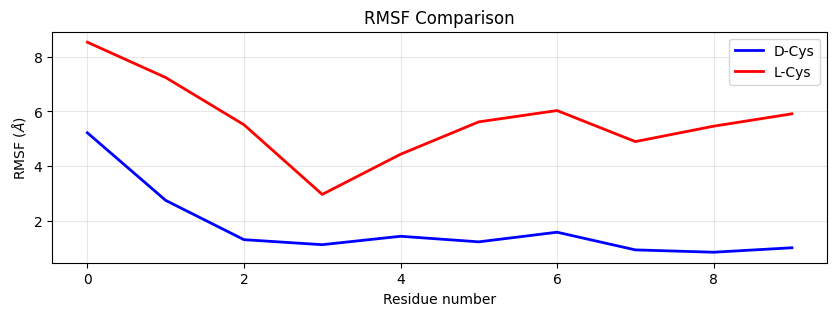

In [ ]:

# RMSF (we ended up not using this in the report):

# RMSF for D-Cys
DCys_CA_atoms = DCysTraj.topology.select("name CA")
DCys_rmsf = md.rmsf(DCysTraj, None, atom_indices=DCys_CA_atoms, precentered=False)

# RMSF for L-Cys
LCys_CA_atoms = LCysTraj.topology.select("name CA")
LCys_rmsf = md.rmsf(LCysTraj, None, atom_indices=LCys_CA_atoms, precentered=False)

plt.figure(figsize=(10, 3))
plt.plot(10*DCys_rmsf, color='blue', label='D-Cys', linewidth=2)
plt.plot(10*LCys_rmsf, color='red', label='L-Cys', linewidth=2)
plt.title('RMSF Comparison')
plt.xlabel("Residue number")
plt.ylabel(r'RMSF ($\AA$)')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()


D-Cys average: [100.73433]
D-Cys average: 38.944107
L-Cys average: [74.82363]
L-Cys average: 30.540468


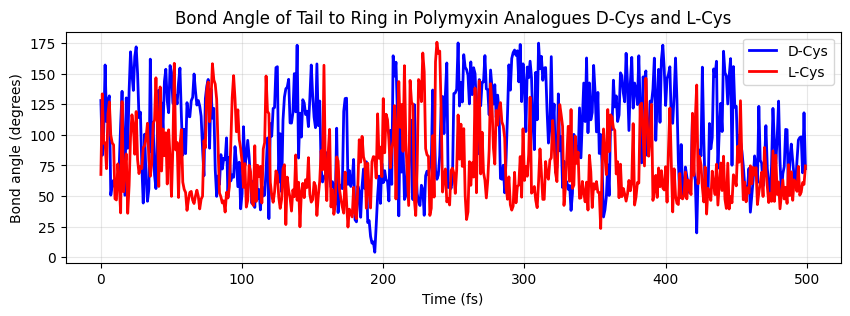

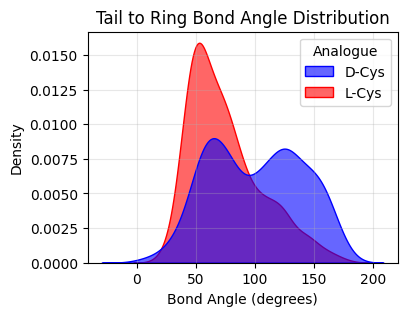

In [39]:
# angle of first atom, joining atom, final atom (including cycle)
angle_indices = [16, 39, 85]
tstart = 0
tlength = 500

bondangle_L = (180/np.pi)* md.compute_angles(LCysTraj, [angle_indices])[tstart:tstart+tlength]
bondangle_D = (180/np.pi)* md.compute_angles(DCysTraj, [angle_indices])[tstart:tstart+tlength]


# statistics
print('D-Cys average:', sum(bondangle_D)/500)
print('D-Cys average:', np.std(bondangle_D))

print('L-Cys average:', sum(bondangle_L)/500)
print('L-Cys average:', np.std(bondangle_L))


# time series graph
plt.figure(figsize=(10, 3))
plt.plot(bondangle_D, color='blue', label='D-Cys', linewidth=2)
plt.plot(bondangle_L, color='red', label='L-Cys', linewidth=2)
plt.xlabel('Time (fs)')
plt.ylabel('Bond angle (degrees)')
plt.title('Bond Angle of Tail to Ring in Polymyxin Analogues D-Cys and L-Cys')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()


# density plot
df_d = pd.DataFrame({'angle': bondangle_D.flatten(), 'Analogue': 'D-Cys'})
df_l = pd.DataFrame({'angle': bondangle_L.flatten(), 'Analogue': 'L-Cys'})
df_combined = pd.concat([df_d, df_l], ignore_index=True)
plt.figure(figsize=(4, 3))
sns.kdeplot(data=df_combined, x='angle', hue='Analogue', fill=True, alpha=0.6, common_norm=False, palette=['blue', 'red'])
plt.xlabel('Bond Angle (degrees)')
plt.ylabel('Density')
plt.title('Tail to Ring Bond Angle Distribution')
plt.grid(True, alpha=0.3)
plt.show()

D-Cys average: [115.394264]
D-Cys average: 32.918694
L-Cys average: [54.326122]
L-Cys average: 23.99607


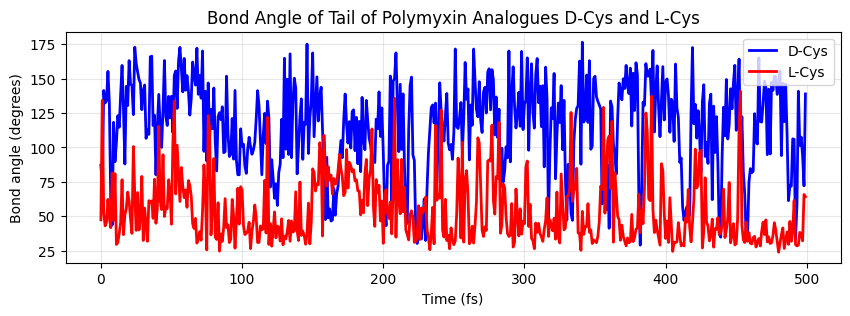

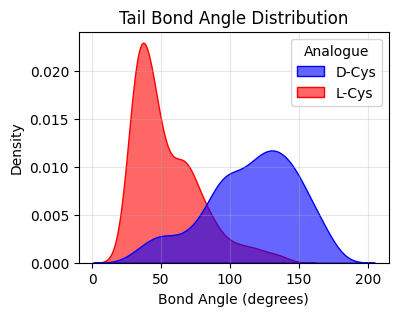

In [42]:
# first atom, middle, and final atom of tail
angle_indices = [16, 0, 39]
tstart = 0
tlength = 500

bondangle_L = (180/np.pi)* md.compute_angles(LCysTraj, [angle_indices])[tstart:tstart+tlength]
bondangle_D = (180/np.pi)* md.compute_angles(DCysTraj, [angle_indices])[tstart:tstart+tlength]


# statistics
print('D-Cys average:', sum(bondangle_D)/500)
print('D-Cys average:', np.std(bondangle_D))

print('L-Cys average:', sum(bondangle_L)/500)
print('L-Cys average:', np.std(bondangle_L))


# time series plot
plt.figure(figsize=(10, 3))
plt.plot(bondangle_D, color='blue', label='D-Cys', linewidth=2)
plt.plot(bondangle_L, color='red', label='L-Cys', linewidth=2)
plt.xlabel('Time (fs)')
plt.ylabel('Bond angle (degrees)')
plt.title('Bond Angle of Tail of Polymyxin Analogues D-Cys and L-Cys')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()


# density plot
df_d = pd.DataFrame({'angle': bondangle_D.flatten(), 'Analogue': 'D-Cys'})
df_l = pd.DataFrame({'angle': bondangle_L.flatten(), 'Analogue': 'L-Cys'})
df_combined = pd.concat([df_d, df_l], ignore_index=True)
plt.figure(figsize=(4, 3))
sns.kdeplot(data=df_combined, x='angle', hue='Analogue', fill=True, alpha=0.6, common_norm=False, palette=['blue', 'red'])
plt.xlabel('Bond Angle (degrees)')
plt.ylabel('Density')
plt.title('Tail Bond Angle Distribution')
plt.grid(True, alpha=0.3)
plt.show()

D-Cys average: [13.743834]
D-Cys SD: 3.7605858
L-Cys average: [7.746919]
L-Cys SD: 3.0219812


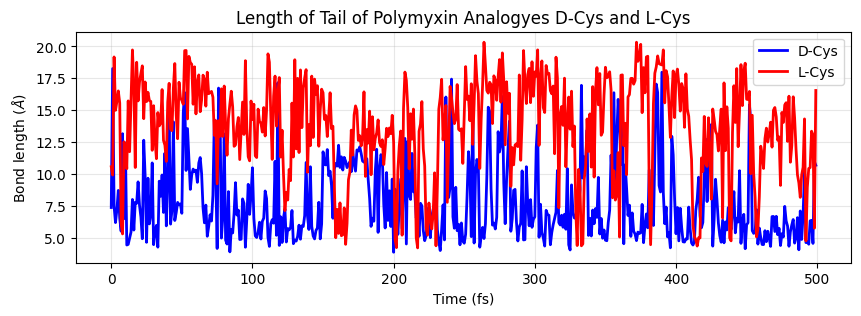

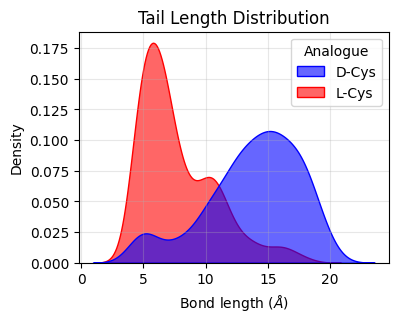

In [46]:
# bond length for start of tail to end of tail
bond_indices = [16, 39]
tstart = 0
tlength = 500

N_CA_bondlength_L = 10*md.compute_distances(LCysTraj, [bond_indices])[tstart:tstart+tlength]
N_CA_bondlength_D = 10*md.compute_distances(DCysTraj, [bond_indices])[tstart:tstart+tlength]


# statistics
print('D-Cys average:', sum(N_CA_bondlength_D)/500)
print('D-Cys SD:', np.std(N_CA_bondlength_D))

print('L-Cys average:', sum(N_CA_bondlength_L)/500)
print('L-Cys SD:', np.std(N_CA_bondlength_L))


# time series graph
plt.figure(figsize=(10, 3))
plt.plot(N_CA_bondlength_L, color='blue', label='D-Cys', linewidth=2)
plt.plot(N_CA_bondlength_D, color='red', label='L-Cys', linewidth=2)
plt.legend()
plt.grid(True, alpha=0.3)
plt.xlabel("Time (fs)")
plt.ylabel(r'Bond length ($\AA$)')
plt.title('Length of Tail of Polymyxin Analogyes D-Cys and L-Cys')
plt.show()


# density plot
df_d = pd.DataFrame({'angle': N_CA_bondlength_D.flatten(), 'Analogue': 'D-Cys'})
df_l = pd.DataFrame({'angle': N_CA_bondlength_L.flatten(), 'Analogue': 'L-Cys'})
df_combined = pd.concat([df_d, df_l], ignore_index=True)
plt.figure(figsize=(4, 3))
sns.kdeplot(data=df_combined, x='angle', hue='Analogue', fill=True, alpha=0.6, common_norm=False, palette=['blue', 'red'])
plt.xlabel(r'Bond length ($\AA$)')
plt.ylabel('Density')
plt.title('Tail Length Distribution')
plt.grid(True, alpha=0.3)
plt.show()

D-Cys average: [15.804139]
D-Cys SD: 5.700662
L-Cys average: [8.709044]
L-Cys SD: 3.817513


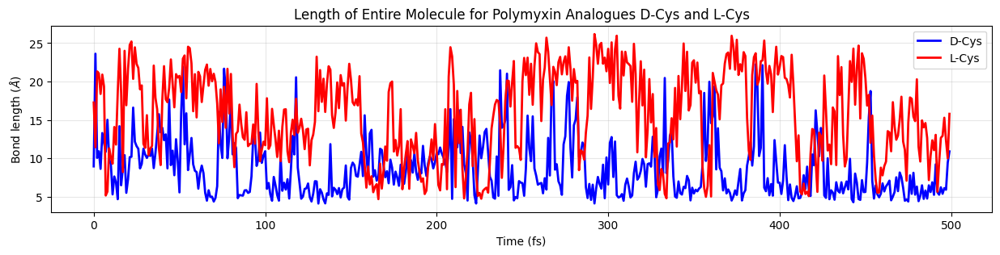

In [ ]:
# bond length for start of tail to end of entire molecule (we didn't end up using this in the analysis)

bond_indices = [16, 85]
tstart = 0
tlength = 500

N_CA_bondlength_L = md.compute_distances(LCysTraj, [bond_indices])
N_CA_bondlength_D = md.compute_distances(DCysTraj, [bond_indices])


# statistics
print('D-Cys average:', sum(10*N_CA_bondlength_D[tstart:tstart+tlength])/500)
print('D-Cys SD:', np.std(10*N_CA_bondlength_D[tstart:tstart+tlength]))

print('L-Cys average:', sum((10*N_CA_bondlength_L[tstart:tstart+tlength])/500))
print('L-Cys SD:', np.std(10*N_CA_bondlength_L[tstart:tstart+tlength]))

# time series plot
plt.figure(figsize=(15, 3))
plt.plot(10*N_CA_bondlength_L[tstart:tstart+tlength], color='blue', label='D-Cys', linewidth=2)
plt.plot(10*N_CA_bondlength_D[tstart:tstart+tlength], color='red', label='L-Cys', linewidth=2)
plt.legend()
plt.grid(True, alpha=0.3)
plt.xlabel("Time (fs)")
plt.ylabel(r'Bond length ($\AA$)')
plt.title('Length of Entire Molecule for Polymyxin Analogues D-Cys and L-Cys')
plt.show()

D-Cys Rg average: 0.7217
D-Cys Rg std: 0.0673
L-Cys Rg average: 0.6792
L-Cys Rg std: 0.0375


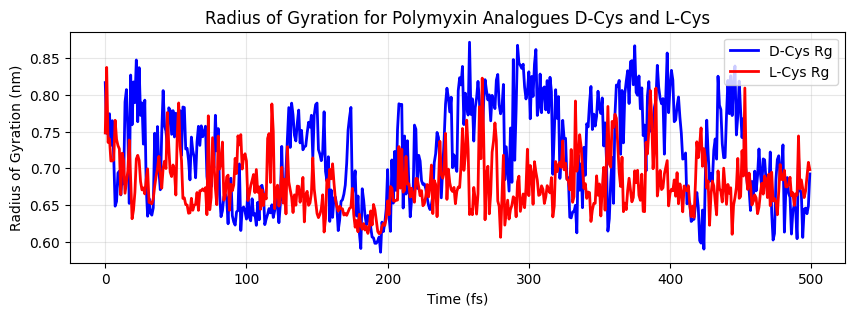

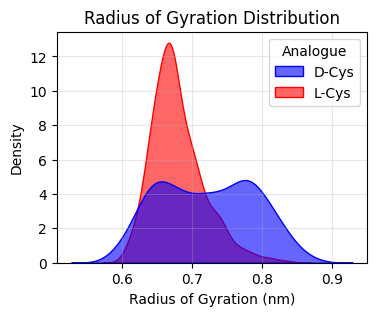

In [38]:
# radius of gyration for the same atoms
angle_indices = [16, 39, 85]
tstart = 0
tlength = 500

rog_L = md.compute_rg(LCysTraj)[tstart:tstart+tlength]
rog_D = md.compute_rg(DCysTraj)[tstart:tstart+tlength]

# statistics
print('D-Cys Rg average:', sum(rog_D)/500)
print('D-Cys Rg SD:', (np.std(rog_D)))

print('L-Cys Rg average:', sum(rog_L)/500)
print('L-Cys Rg SD:', np.std(rog_L))

# time series
plt.figure(figsize=(10, 3))
plt.plot(rog_D, color='blue', label='D-Cys Rg', linewidth=2)
plt.plot(rog_L, color='red', label='L-Cys Rg', linewidth=2)
plt.xlabel('Time (fs)')
plt.ylabel('Radius of Gyration (nm)')
plt.legend()
plt.grid(True, alpha=0.3)
plt.title('Radius of Gyration for Polymyxin Analogues D-Cys and L-Cys')
plt.show()

# density plot
df_d = pd.DataFrame({'angle': rog_D.flatten(), 'Analogue': 'D-Cys'})
df_l = pd.DataFrame({'angle': rog_L.flatten(), 'Analogue': 'L-Cys'})
df_combined = pd.concat([df_d, df_l], ignore_index=True)
plt.figure(figsize=(4, 3))
sns.kdeplot(data=df_combined, x='angle', hue='Analogue', fill=True, alpha=0.6, common_norm=False, palette=['blue', 'red'])
plt.xlabel('Radius of Gyration (nm)')
plt.ylabel('Density')
plt.title('Radius of Gyration Distribution')
plt.grid(True, alpha=0.3)
plt.show()